In [1]:
import os
import numpy as np
import pandas as pd
import seaborn as sns

In [2]:
plt.rcParams['figure.dpi'] = 300
sns.set_context('talk', font_scale= 1.2)

# Figure 3A

In [9]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_path = os.path.join(subsample_path, '20200508_maternal500_fetal_wo_outliers.csv')
adata_df = pd.read_csv(umap_path)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [10]:
clean_df = adata_df[(adata_df['test_status'] == 'test') & 
                    adata_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
bl_df = clean_df[(clean_df['challenge'] == 'sal') & (clean_df['timePI'] == '2hr') & (clean_df['origin'] == 'maternal')]

In [12]:
bl_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'umap1', 'umap2',
       'cell_type_v2', 'compartment2'],
      dtype='object')

In [11]:
leiden_color_dictv2 = {'B cells': '#FFFF00',
 'CD4+ T cells': '#FF34FF',
 'CD8+ T cells': '#FF4A46',
 'Eosinophils': '#A30059',
 'Basophils': '#b98cdb',
 'Monocytes': '#552de3',
 'NK cells': '#8FB0FF',
 'Neutrophils': '#8393a3',                   
 'DCs': '#1CE6FF'}

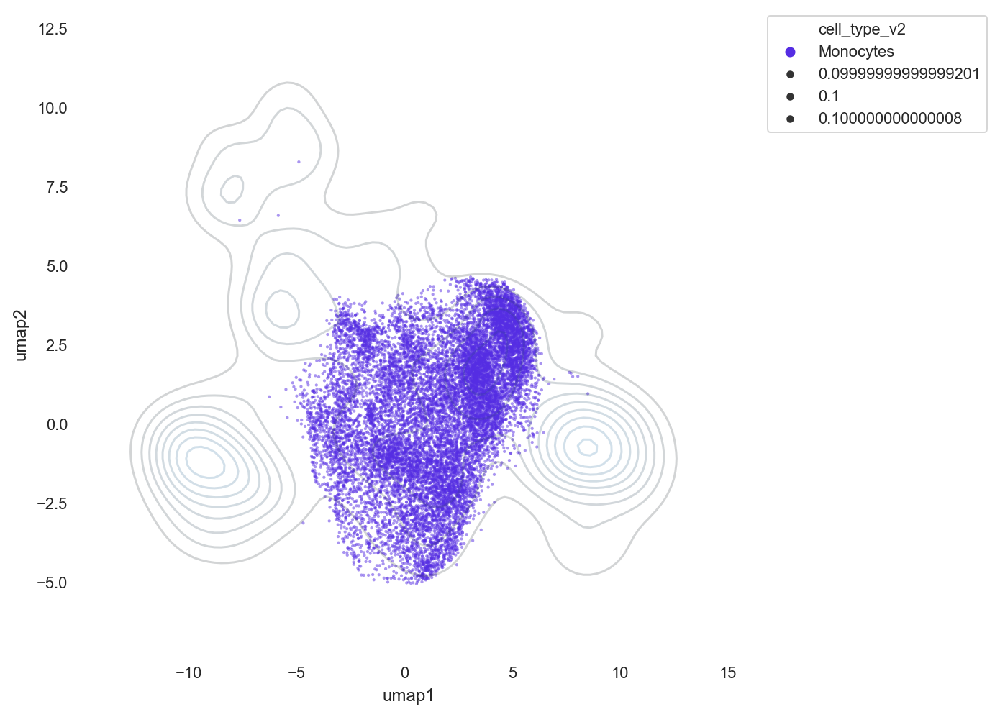

In [14]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = bl_df['umap1'], data2= bl_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)

sns.scatterplot(data = bl_df[bl_df['cell_type_v2']=='Monocytes'], 
                hue = 'cell_type_v2', palette = leiden_color_dictv2, x='umap1', y='umap2', marker='.', size = 0.1, 
                linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supplementary Figure 3A

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_csv = '20200928_MO_bl_maternal500wo_outliers.csv'
umap_filepath = os.path.join(subsample_path, umap_csv)
mono_df= pd.read_csv(umap_filepath)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [19]:
mono_clean_df = mono_df[(mono_df['test_status'] == 'test') & mono_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]

In [20]:
mono_clean_df['Mo_leiden2'].unique()

array([6, 1, 0, 3, 8, 7, 4, 2, 5, 9])

In [21]:
mono_clean_df['Mo_leiden2'] = mono_clean_df['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [95]:
Mo_leiden2_dict = {'0': '#d67c0d',
'1': '#32a852',
'2': '#876507',
'3': '#d6bcc0',
'4': '#023fa5',
'5': '#d60d0d',
'6': '#d60dcf',
'7': '#0dd6d3',
'8': '#772d91',
'9': '#d6d60d'}

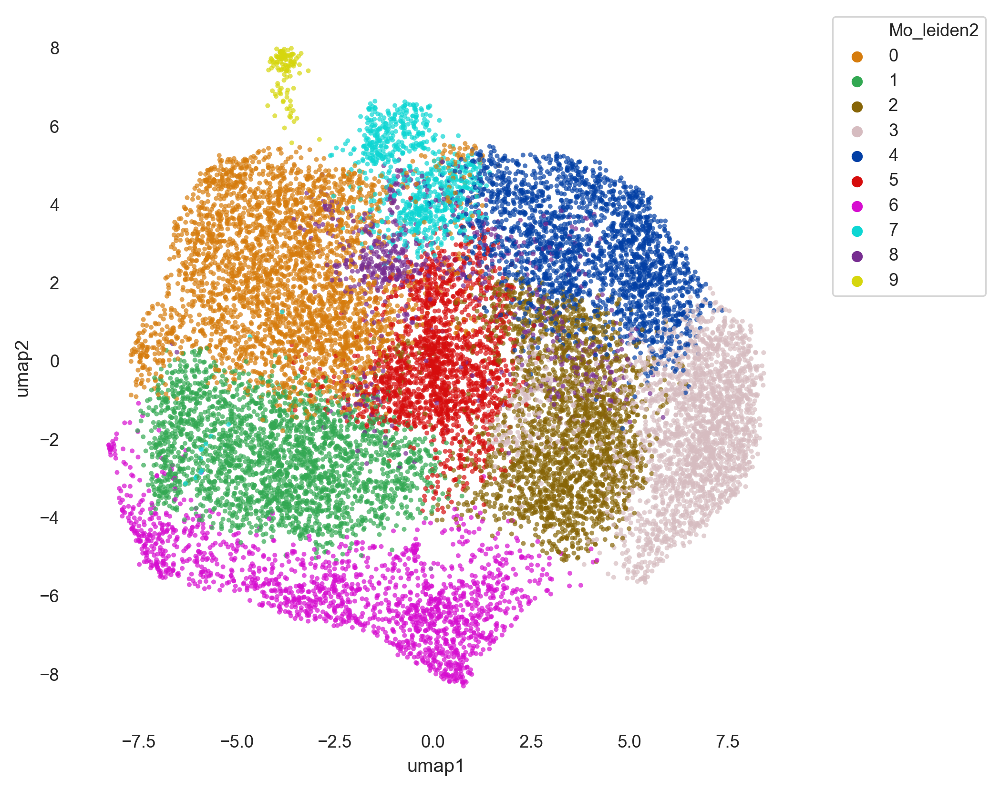

In [24]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = mono_clean_df, 
                hue = 'Mo_leiden2', hue_order = ['0', '1', '2', '3', '4', '5','6', '7', '8', '9'],
                palette = Mo_leiden2_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supplementary figure 3b

In [25]:
clustering = ['IdU',
 'CD11c',
 'F480',
 'CD64',
 'CD68',
 'CD86',
 'CD80',
 'CD11b',
 'Ly-6C',
 'MHCII']

In [26]:
mono_clean_df.columns

Index(['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD194', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86',
       'prpS6', 'day', 'organ', 'id', 'cage', 'timePI', 'challenge', 'origin',
       'location', 'leiden1', 'PD-L1_status', 'PD-1_status', 'CTLA-4_status',
       'CD64_status', 'CD62L_status', 'CD25_status', 'CD194_status',
       'CD69_status', 'CD80_status', 'CD86_status', 'B220_status',
       'CD40_status', 'CD44_status', 'IdU_status', 'cell_descript',
       'test_status', 'sample', 'cell_type', 'compartment', 'leiden0',
       'gen_cell_type', 'cell_type_v2', 'compartment2', 'Mo_leiden2', 'umap1',
       'umap2'],
      dtype='object')

In [27]:
mono_clean_df[clustering] = mono_clean_df[clustering].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
mono_melt= mono_clean_df.melt(id_vars=['compartment2','Mo_leiden2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = clustering)
mono_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/pandas/core/frame.py:3391: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self[k1] = value[k2]


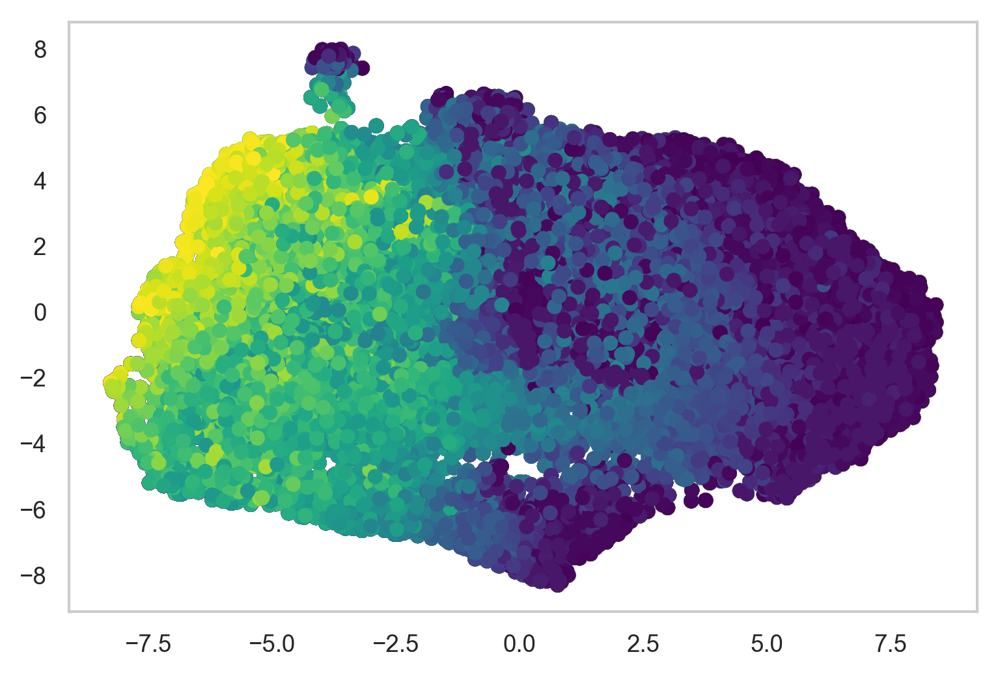

In [28]:
points = plt.scatter(mono_melt['umap1'], mono_melt['umap2'], c = mono_melt['median'], cmap='viridis')

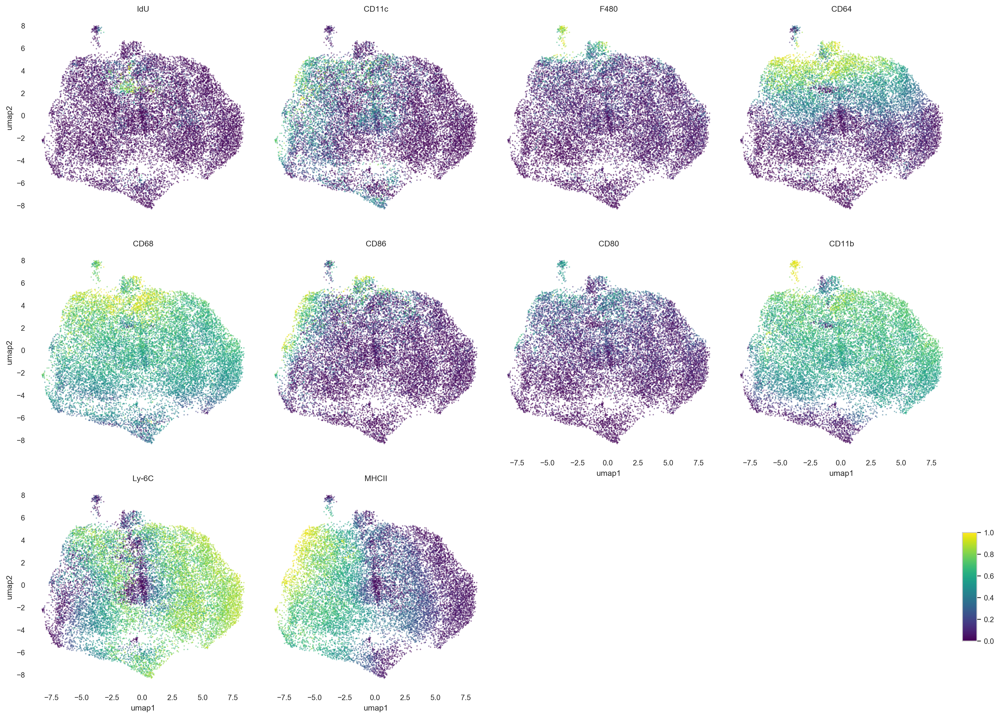

In [29]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= mono_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=4,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

In [52]:
figure_markers = ['Ly-6C', 'PD-L1', 'MHCII', 'CD64']

In [53]:
mono_clean_df[figure_markers] = mono_clean_df[figure_markers].apply(lambda x:(x-x.min()) / (x.max()-x.min()))
mono_melt= mono_clean_df.melt(id_vars=['compartment2','Mo_leiden2', 'cage','id', 'day', 'umap1', 'umap2'], value_vars = figure_markers)
mono_melt.rename(columns = {'variable': 'marker', 'value': 'median'}, inplace = True)

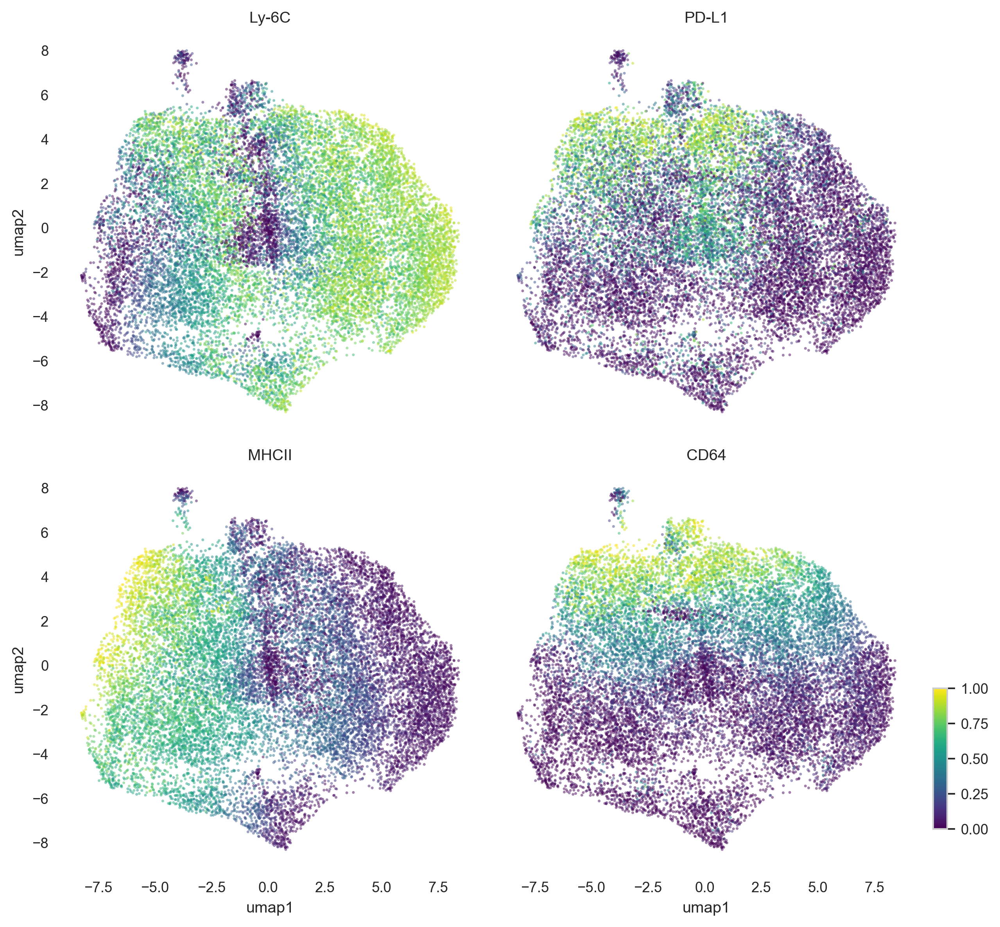

In [55]:
sns.set_context('paper', font_scale= 1)
g = sns.relplot(x='umap1', y= 'umap2', hue = 'median', col= 'marker', data= mono_melt,
                height=4, aspect=1, kind="scatter", palette = 'viridis', col_wrap=2,
                marker='.', size = 0.1, linewidth = 0, alpha = 0.5, legend = False).set_titles('{col_name}')
cax = g.fig.add_axes([1, .11, 0.015, 0.15])
plt.colorbar(points, cax=cax)
sns.despine(g, left=True, bottom=True)

# Figure 3B

In [3]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_csv = '20200928_MO_bl_maternal500wo_outliers.csv'
umap_filepath = os.path.join(subsample_path, umap_csv)
mono_df= pd.read_csv(umap_filepath)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3049: DtypeWarning: Columns (42) have mixed types. Specify dtype option on import or set low_memory=False.
  interactivity=interactivity, compiler=compiler, result=result)


In [4]:
columns_int = ['CD45-retroorbital', 'CD45.2', 'CD45.1', 'IdU', 'B220', 'Ly-6G',
       'CD11c', 'TCRb', 'CD115', 'CD69', 'F480', 'CD3', 'IgD', 'CD19', 'CD25',
       'CD64', 'CD80', 'CD8', 'CD11b', 'CD40', 'IgM', 'c-Kit', 'FOXP3',
       'TCRgd', 'CTLA-4', 'Ly-6C', 'CD62L', 'PD-L1', 'FcERI', 'NKp46',
       'Siglec-F', 'CD68', 'CD49b', 'CD44', 'CD4', 'PD-1', 'MHCII', 'CD86', 'cage','challenge', 'day', 'id', 'Mo_leiden2', 'compartment2']

In [5]:
mono_clean_df = mono_df[(mono_df['test_status'] == 'test') & mono_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]
pivot_series = mono_clean_df[columns_int].pivot_table(columns= ['Mo_leiden2', 'compartment2','challenge', 'cage','id', 'day'], aggfunc = 'median')

In [6]:
median_df = pd.DataFrame(pivot_series)
median_df.reset_index(inplace = True)
median_df.rename(columns = {'level_0': 'marker', 0: 'median'}, inplace = True)
mean_medians = median_df.groupby(['marker','Mo_leiden2']).mean()
mean_medians.reset_index(inplace = True)
heatmap_df = mean_medians.pivot_table(index = 'marker', columns = 'Mo_leiden2', values = 'median')

In [7]:
heatmap_ready = heatmap_df.apply(lambda x:(x-x.min()) / (x.max()-x.min()), axis = 1)

In [8]:
heatmap_ready

Mo_leiden2,0,1,2,3,4,5,6,7,8,9
marker,,,,,,,,,,
B220,0.348735,0.112154,0.069171,0.000000,0.229316,0.082086,0.131721,0.694914,0.347474,1.000000
CD115,0.354855,0.134935,0.215808,0.125136,0.278978,0.337647,0.000000,0.543017,0.279520,1.000000
CD11b,0.632760,0.510342,0.612543,0.607040,0.658460,0.579292,0.000000,0.634804,0.567682,1.000000
CD11c,0.903988,0.653419,0.000000,0.004681,0.084375,1.000000,0.805823,0.831302,0.265556,0.137997
CD19,0.133207,0.092252,0.047833,0.038258,0.049079,0.042408,0.000000,0.300258,0.094865,1.000000
CD25,0.217113,0.037957,0.083077,0.056056,0.146251,0.023154,0.000000,0.364628,0.162060,1.000000
CD3,0.159496,0.054502,0.042420,0.000000,0.072785,0.015805,0.010303,0.259639,0.142930,1.000000
CD4,0.979572,0.583928,0.580387,0.471698,0.793705,0.850040,0.212433,1.000000,0.523361,0.000000
CD40,0.703538,0.248977,0.287898,0.000000,0.362996,0.185470,0.741372,0.974847,0.484700,1.000000


In [9]:
heatmap_ready.columns = heatmap_ready.columns.astype('str')

In [10]:
heat_t = heatmap_ready.loc[:, ['9','7', '5', '0', '1', '6', '8', '4','3', '2']]

In [11]:
markers_int = ['Ly-6C',
               'CD11b',
               'CD11c',
               'CD64',
               'CD68',
               'CD80',
               'CD86',
               'IdU',
               'F480',
               'MHCII',
               'PD-L1']

In [165]:
Mo_leiden2_dict = {'0':'#66a61e',
'1': '#d6bcc0' ,
'2': '#876507',
'3': '#d67c0d',
'4': '#023fa5',
'5': '#e7298a',
'6': '#d60d0d',
'7': '#7570b3',
'8': '#772d91',
'9': '#d6d60d'}

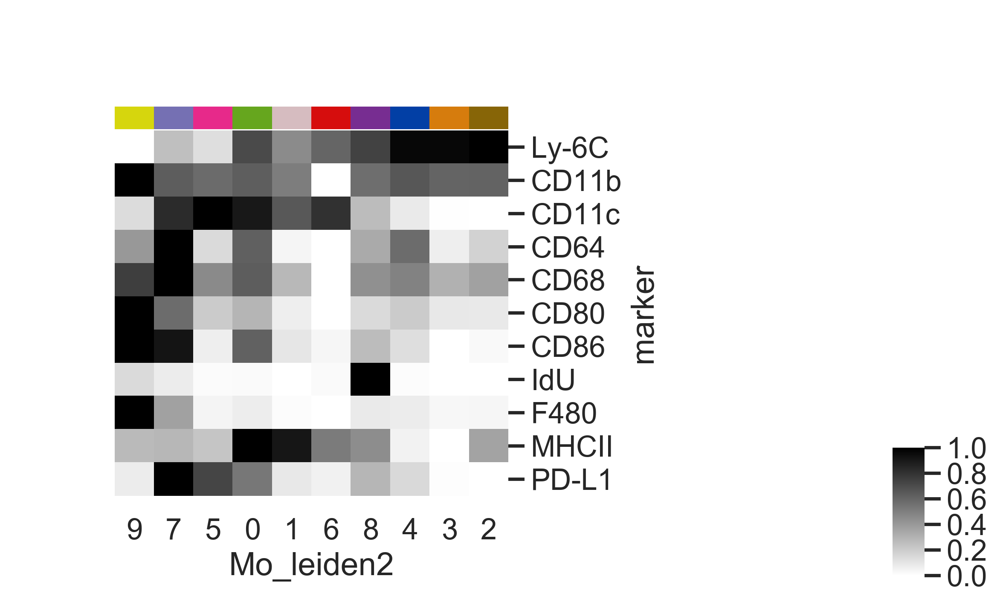

In [160]:
sns.set_context('talk', font_scale= 1)
col_colors = heat_t.columns.map(Mo_leiden2_dict)
cg = sns.clustermap(heat_t.loc[markers_int, :], figsize=(5,5),
               cmap = 'binary', col_colors = col_colors,
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.2))

In [43]:
cell_counts = pd.DataFrame(data = mono_clean_df.groupby(['Mo_leiden2', 'compartment2', 'organ', 'location','day', 'challenge','timePI','cage', 'id', 'test_status']).apply(len))
cell_counts.reset_index(inplace = True)
cell_counts.rename(columns = {0: 'counts'}, inplace = True)
cell_counts['sample'] = cell_counts['cage'].astype(str).str.cat(cell_counts['id'].astype(str), sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['day'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['challenge'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['timePI'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['organ'], sep= '_')
cell_counts['sample'] = cell_counts['sample'].str.cat(cell_counts['location'], sep= '_')
sample_total = pd.DataFrame(data = cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
cell_counts.loc[:,'sample_total'] = cell_counts['sample'].map(sample_dict['counts'])
cell_counts['frac_of_comp_sample'] = cell_counts['counts']/cell_counts['sample_total']
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200929_nopld1clustmaternalmo_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts.to_csv(counts_filepath, index = False)                                                 

In [97]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200929_nopld1clustmaternalmo_edited_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
cell_counts= pd.read_csv(counts_filepath)                                                 

In [98]:
cell_counts['Mo_leiden2'] = cell_counts['Mo_leiden2'].astype('str')

In [99]:
clean_cell_counts = cell_counts[cell_counts['test_status'] == 'test']
clean_cell_counts['cage'] = clean_cell_counts['cage'].astype('category')
composite = clean_cell_counts.groupby(['Mo_leiden2', 'day','compartment2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)

In [100]:
composite_frac_all = pd.DataFrame(data = mean_sem_comp['mean']['frac_of_comp_sample'])
composite_frac_all.reset_index(inplace = True)
heatmap_all = composite_frac_all.pivot_table(index = ['Mo_leiden2'], columns = 'compartment2', values = 'frac_of_comp_sample')
heatmap_all= heatmap_all.fillna(0)

In [101]:
heatmap_all=heatmap_all.loc[:,['PL-T', 'PL-EV', 'PB-EV']]

In [102]:
heat_counts = heatmap_all.loc[['9','7', '5', '0', '1', '6', '8', '4','3', '2'], :]

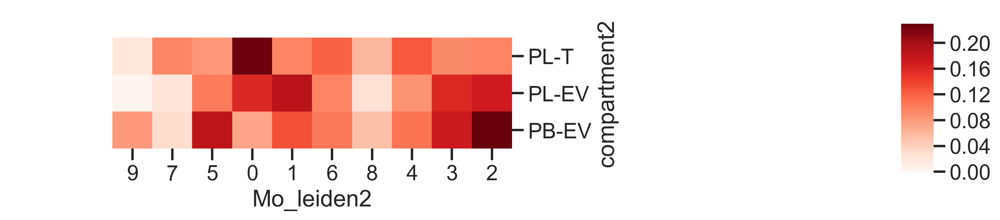

In [103]:
cg = sns.clustermap(heat_counts.transpose(), figsize=(7, 2),
               cmap = 'Reds',  
               row_cluster = False, col_cluster = False)
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)
cg.cax.set_position((1.5,0.0,.05,.8))

# Supplemental Figure 3C

In [17]:
mono_df.head(5)

,CD45-retroorbital,CD45.2,CD45.1,IdU,B220,Ly-6G,CD11c,TCRb,CD115,CD69,...,sample,cell_type,compartment,leiden0,gen_cell_type,cell_type_v2,compartment2,Mo_leiden2,umap1,umap2
0,1.258668,0.000000,0.000000,0.000362,1.198608,0.089487,0.008133,0.087274,0.260939,0.042142,...,E12.5_3576_15,Monocytes Ly6Cmid,PB-EV,13,Mo,Monocytes,PB-EV,6,-6.524808,-4.749165
1,1.082973,1.363153,0.840650,0.111562,1.477056,0.407332,0.912588,0.497060,0.186208,0.002609,...,E12.5_3576_15,Monocytes Ly6Cmid,PB-EV,3,DCs,Monocytes,PB-EV,1,-5.761338,-3.520265
2,0.938936,2.982383,0.000000,0.000362,0.512983,0.089487,0.008133,0.087274,0.004988,0.002609,...,E12.5_3576_15,Monocytes Ly6Cmid,PB-EV,13,Mo,Monocytes,PB-EV,6,-6.931229,-5.427559
3,0.760537,0.450320,0.000000,0.000362,1.103142,0.444793,0.008133,1.028354,0.187366,0.002609,...,E12.5_3576_15,Monocytes Ly6Cmid,PB-EV,3,DCs,Monocytes,PB-EV,1,-4.369278,-2.871891
4,3.782049,2.699717,0.155674,0.000362,1.074291,0.380784,0.008133,0.087274,0.004988,0.002609,...,E12.5_3576_15,Monocytes Ly6Cmid,PB-EV,13,Mo,Monocytes,PB-EV,6,-7.138829,-5.227816


In [65]:
mono_df['Ly-6C'].describe()

count    18273.000000
mean         4.062193
std          1.976173
min          0.008061
25%          2.793338
50%          4.688984
75%          5.668695
max          7.075890
Name: Ly-6C, dtype: float64

In [83]:
mono_df['canonical_cat']= 'non_classical'

In [84]:
int_mask = (mono_df['Ly-6C'] >= 2.5)

In [85]:
mono_df['canonical_cat'][int_mask] = 'intermediate'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [86]:
class_mask = (mono_df['Ly-6C'] >= 4.5)

In [87]:
mono_df['canonical_cat'][class_mask] = 'classical'

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [88]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_csv = '20200928_MO_bl_maternal500wo_outliers.csv'
umap_filepath = os.path.join(subsample_path, umap_csv)
mono_df.to_csv(umap_filepath, index = False)

In [28]:
mono_class_dict = {'classical': '#babdc2',
                   'intermediate': '#2c2145',
                   'non_classical': '#f2f207'}

In [58]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
umap_csv = '20200928_MO_bl_maternal500wo_outliers.csv'
umap_filepath = os.path.join(subsample_path, umap_csv)
mono_df = pd.read_csv(umap_filepath)

In [59]:
mono_clean_df = mono_df[(mono_df['test_status'] == 'test') & mono_df['organ'].isin(['PB', 'PL_F', 'PL_M'])]

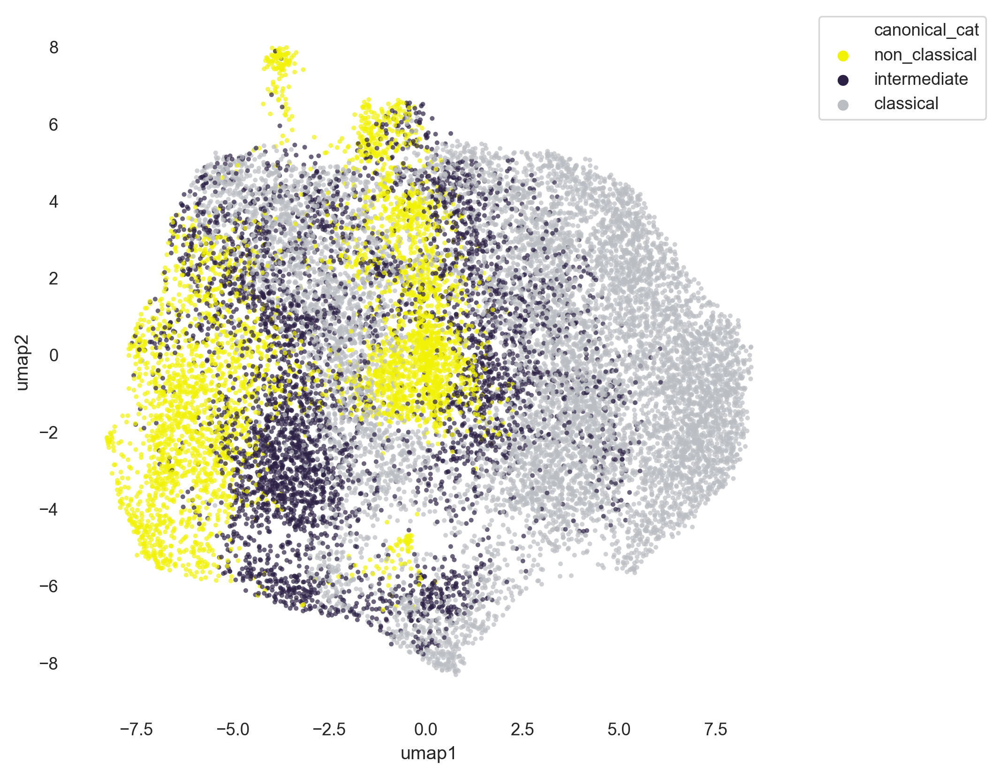

In [91]:
sns.set_context('paper', font_scale= 1)
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.scatterplot(x='umap1', y='umap2', 
                data = mono_df, 
                hue = 'canonical_cat',
                palette = mono_class_dict, 
                marker='.', linewidth = 0, alpha = 0.7)
sns.set_style("whitegrid", {'axes.grid' : False})
sns.despine(f, left=True, bottom=True)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

In [66]:
mono_clean_df['sample'].unique()

array(['E12.5_3576_15', 'E12.5_3574_1', 'E14.5_2991_5', 'E15.5_9582_14',
       'E16.5_9580_3', 'E14.5_1136_1', 'E18.5_8241_18', 'E12.5_8238_1',
       'E14.5_8240_11', 'E12.5_0748_5', 'E14.5_1137_8', 'E12.5_2850_18',
       'E12.5_2849_11', 'E10.5_6943_15', 'E14.5_0439_6', 'E17.5_6942_9',
       'E10.5_6944_17', 'E11.5_6942_10', 'E18.5_8241_17', 'E14.5_0438_4',
       'E17.5_6941_3', 'E17.5_6941_5', 'E10.5_6942_8', 'E10.5_6944_16',
       'E14.5_9581_10', 'E14.5_9581_8', 'E14.5_9581_9', 'E15.5_9581_7',
       'E15.5_9582_11', 'E13.5_9580_2', 'E13.5_9583_19', 'E13.5_9583_20',
       'E10.5_9582_15', 'E16.5_9580_4', 'E16.5_9580_5', 'E12.5_9583_18',
       'E12.5_8238_4', 'E12.5_8238_4-5', 'E12.5_8238_4-6',
       'E12.5_8238_4-7', 'E11.5_0429_19', 'E11.5_6943_13',
       'E12.5_0428_14', 'E18.5_0428_13', 'E18.5_0429_16', 'E18.5_0429_20'],
      dtype=object)

In [70]:
mono_clean_df['id'] = mono_clean_df['id'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [72]:
mono_clean_df['id'].unique()

array(['15', '1', '5', '14', '3', '18', '11', '8', '6', '9', '17', '10',
       '4', '16', '7', '2', '19', '20', '4-5', '4-6', '4-7', '13'],
      dtype=object)

In [73]:
class_cell_counts = pd.DataFrame(data = mono_clean_df.groupby(['Mo_leiden2','canonical_cat','timePI','cage', 'id', 'test_status']).apply(len))
class_cell_counts.reset_index(inplace = True)
class_cell_counts.rename(columns = {0: 'counts'}, inplace = True)
class_cell_counts['sample'] = class_cell_counts['Mo_leiden2'].astype(str).str.cat(class_cell_counts['id'], sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['cage'].astype(str), sep= '_')
class_cell_counts['sample'] = class_cell_counts['sample'].str.cat(class_cell_counts['timePI'].astype(str), sep= '_')

In [74]:
class_cell_counts.head(5)

,Mo_leiden2,canonical_cat,timePI,cage,id,test_status,counts,sample
0,0,classical,24hr,438,4,test,20,0_4_438_24hr
1,0,classical,24hr,439,6,test,17,0_6_439_24hr
2,0,classical,24hr,748,5,test,29,0_5_748_24hr
3,0,classical,24hr,1137,8,test,14,0_8_1137_24hr
4,0,classical,24hr,2850,18,test,42,0_18_2850_24hr


In [75]:
class_cell_counts[(class_cell_counts['sample'] == '0_1_8238_2hr')]

,Mo_leiden2,canonical_cat,timePI,cage,id,test_status,counts,sample
23,0,classical,2hr,8238,1,test,19,0_1_8238_2hr
68,0,intermediate,2hr,8238,1,test,10,0_1_8238_2hr
113,0,non_classical,2hr,8238,1,test,6,0_1_8238_2hr


In [76]:
sample_total = pd.DataFrame(data = class_cell_counts.groupby(['sample']).sum())
sample_dict = sample_total.to_dict()
class_cell_counts.loc[:,'sample_total'] = class_cell_counts['sample'].map(sample_dict['counts'])
class_cell_counts['frac_of_comp_sample'] = class_cell_counts['counts']/class_cell_counts['sample_total'] 

subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '202010_mo_class_counts.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
class_cell_counts.to_csv(counts_filepath, index = False)

In [77]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '202010_mo_class_counts.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
class_cell_counts= pd.read_csv(counts_filepath)

In [78]:
class_cell_counts.head(5)

,Mo_leiden2,canonical_cat,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample
0,0,classical,24hr,438,4,test,20,0_4_438_24hr,60,0.333333
1,0,classical,24hr,439,6,test,17,0_6_439_24hr,55,0.309091
2,0,classical,24hr,748,5,test,29,0_5_748_24hr,58,0.500000
3,0,classical,24hr,1137,8,test,14,0_8_1137_24hr,48,0.291667
4,0,classical,24hr,2850,18,test,42,0_18_2850_24hr,68,0.617647


In [79]:
test1= class_cell_counts[(class_cell_counts['id'] == '1')&(class_cell_counts['cage'] == 8238)]

In [80]:
test1

,Mo_leiden2,canonical_cat,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample
23,0,classical,2hr,8238,1,test,19,0_1_8238_2hr,35,0.542857
68,0,intermediate,2hr,8238,1,test,10,0_1_8238_2hr,35,0.285714
113,0,non_classical,2hr,8238,1,test,6,0_1_8238_2hr,35,0.171429
156,1,classical,2hr,8238,1,test,6,1_1_8238_2hr,25,0.240000
201,1,intermediate,2hr,8238,1,test,7,1_1_8238_2hr,25,0.280000
247,1,non_classical,2hr,8238,1,test,12,1_1_8238_2hr,25,0.480000
293,2,classical,2hr,8238,1,test,23,2_1_8238_2hr,25,0.920000
333,2,intermediate,2hr,8238,1,test,2,2_1_8238_2hr,25,0.080000
373,3,classical,2hr,8238,1,test,19,3_1_8238_2hr,23,0.826087
418,3,intermediate,2hr,8238,1,test,2,3_1_8238_2hr,23,0.086957


In [81]:
cluster_list = class_cell_counts['Mo_leiden2'].unique().astype(str).tolist()

In [82]:
cluster_list

['0', '1', '2', '3', '4', '5', '6', '7', '8', '9']

In [83]:
bl_counts_piv = class_cell_counts.pivot_table(index = ['Mo_leiden2', 'id', 'cage', 'timePI'], columns = 'canonical_cat', values = 'frac_of_comp_sample')
bl_counts_piv.reset_index(inplace = True)
bl_counts_piv.columns = bl_counts_piv.columns.astype(str)
bl_counts_piv.loc[:,'classical': 'non_classical'] = bl_counts_piv.loc[:,'classical': 'non_classical'].fillna(0)
bl_counts_piv.loc[:, 'id':'cage'] = bl_counts_piv.loc[:, 'id':'cage'].astype('category')
composite = bl_counts_piv.groupby(['Mo_leiden2']).agg(['mean', 'sem'])
mean_sem_comp = composite.reorder_levels([1, 0], axis = 1)
composite_T = mean_sem_comp['mean'].transpose()
composite_T.reset_index(inplace = True)

In [84]:
bl_counts_piv.head(5)

canonical_cat,Mo_leiden2,id,cage,timePI,classical,intermediate,non_classical
0,0,1,1136,2hr,0.595238,0.285714,0.119048
1,0,1,3574,24hr,0.450000,0.400000,0.150000
2,0,1,8238,2hr,0.542857,0.285714,0.171429
3,0,10,6942,2hr,0.567164,0.350746,0.082090
4,0,10,9581,2hr,0.431034,0.413793,0.155172


In [85]:
bl_counts_piv['id'].unique()[0]

'1'

In [86]:
test = bl_counts_piv[(bl_counts_piv['id'] == '1')&(bl_counts_piv['cage'] == 8238)]

In [87]:
test

canonical_cat,Mo_leiden2,id,cage,timePI,classical,intermediate,non_classical
2,0,1,8238,2hr,0.542857,0.285714,0.171429
48,1,1,8238,2hr,0.240000,0.280000,0.480000
94,2,1,8238,2hr,0.920000,0.080000,0.000000
140,3,1,8238,2hr,0.826087,0.086957,0.086957
185,4,1,8238,2hr,0.727273,0.227273,0.045455
231,5,1,8238,2hr,0.000000,0.190476,0.809524
277,6,1,8238,2hr,0.214286,0.357143,0.428571
322,7,1,8238,2hr,0.000000,0.200000,0.800000
364,8,1,8238,2hr,0.750000,0.250000,0.000000


In [88]:
test.loc[:, 'classical':'non_classical'].sum(axis = 1)

2      1.0
48     1.0
94     1.0
140    1.0
185    1.0
231    1.0
277    1.0
322    1.0
364    1.0
dtype: float64

In [89]:
composite_T

Mo_leiden2,index,0,1,2,3,4,5,6,7,8,9
0,classical,0.433292,0.194849,0.943433,0.841816,0.826026,0.001760,0.383758,0.095675,0.565406,0.000000
1,intermediate,0.365126,0.409864,0.056567,0.145655,0.157089,0.309139,0.357629,0.304234,0.226048,0.046933
2,non_classical,0.201582,0.395287,0.000000,0.012529,0.016885,0.689101,0.258613,0.600090,0.208545,0.953067


In [90]:
composite_T.columns = composite_T.columns.astype(str)

In [91]:
composite_T = composite_T.loc[:, ['index','9','7', '5', '0', '1', '6', '8', '4','3', '2']]

In [92]:
composite_T.sum(axis = 0)

Mo_leiden2
index    classicalintermediatenon_classical
9                                         1
7                                         1
5                                         1
0                                         1
1                                         1
6                                         1
8                                         1
4                                         1
3                                         1
2                                         1
dtype: object

In [93]:
int_to_mo_class = composite_T[['index']].to_dict()

In [94]:
bars_dict = {}
for mo_class in composite_T.index:
    bars_dict[mo_class] = composite_T.iloc[mo_class, 1:]
height_dict = {}
for mo_class in composite_T.index:
    height_dict[mo_class] = composite_T.iloc[mo_class+1:,1:].sum().tolist()

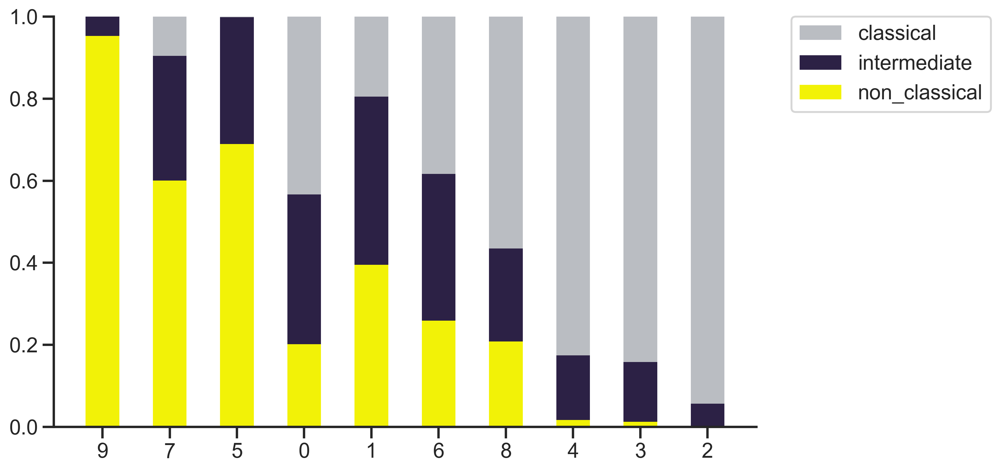

In [95]:
sns.set_style("ticks")
plt.figure(figsize=(10,6)) 
# The position of the bars on the x-axis
r = [0, 0.2, 0.4, 0.6, 0.8, 1.0, 1.2, 1.4, 1.6, 1.8]
 
# Names of group and bar width
names = ['9','7', '5', '0', '1', '6', '8', '4','3', '2']
barWidth = 0.10

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = mono_class_dict[int_to_mo_class['index'][mo_class]], bottom = height_dict[mo_class], width=barWidth, linewidth = 0)
plt.xticks(r, names);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)
sns.despine(right = True, top = True)

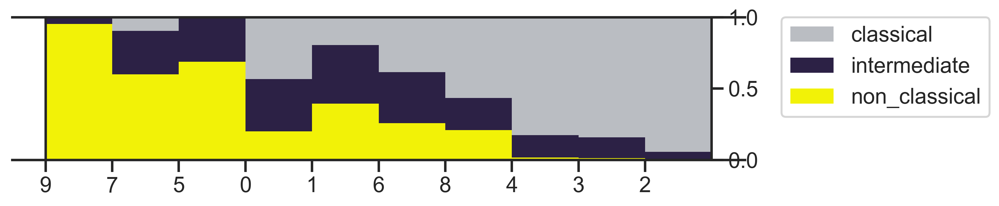

In [164]:
sns.set_style("ticks")
fig = plt.figure(figsize=(10,2))
ax = fig.add_subplot(1, 1, 1)
ax.spines['left'].set_position(('data', 0.0))
ax.spines['right'].set_position(('data', 1.0))
ax.yaxis.tick_right()

# The position of the bars on the x-axis
r = [0,0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
 
# Names of group and bar width
names = ['9','7', '5', '0', '1', '6', '8', '4','3', '2']
barWidth = 0.1

for mo_class in composite_T.index:
    plt.bar(r, bars_dict[mo_class], color = mono_class_dict[int_to_mo_class['index'][mo_class]], 
            bottom = height_dict[mo_class], width=barWidth, linewidth = 0, align = 'edge')
plt.xticks(r, names);
plt.legend(composite_T['index'], bbox_to_anchor=(1.05, 1), borderaxespad=0., ncol=1)

# Figure 3D

In [7]:
median_df.head(5)

,marker,Mo_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.603326
1,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.903420
2,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.715041
3,CD45-retroorbital,0,PB-EV,sal,439,6,E14.5,0.041249
4,CD45-retroorbital,0,PB-EV,sal,748,5,E12.5,1.707534


In [14]:
median_df['Mo_leiden2'] = median_df['Mo_leiden2'].astype('str')

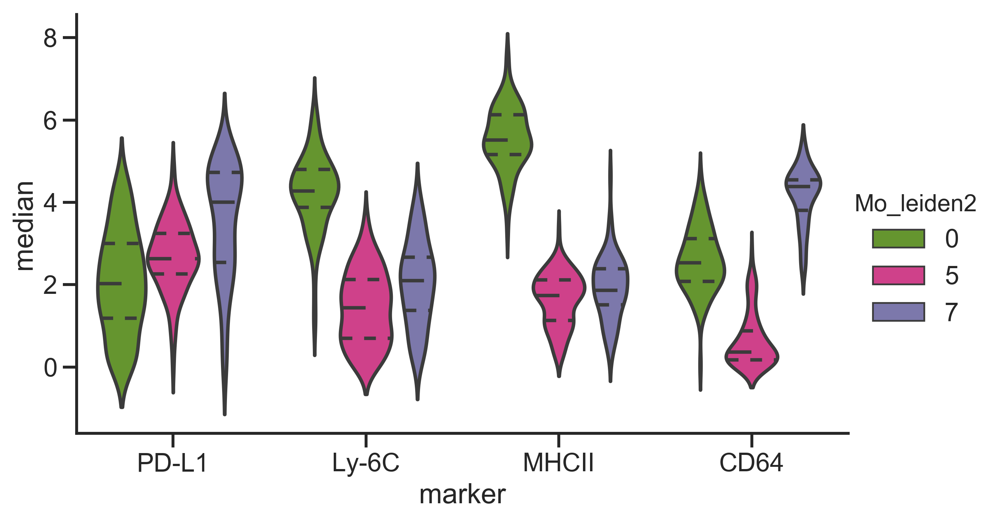

In [166]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Mo_leiden2', palette = Mo_leiden2_dict, order = ['PD-L1', 'Ly-6C','MHCII', 'CD64'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['PD-L1', 'Ly-6C','MHCII', 'CD64']) & median_df['Mo_leiden2'].isin(['0', '5', '7'])],
            legend_out = True, aspect = 1.6, height = 5)

In [64]:
from scipy.stats import ttest_ind

In [66]:
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])

In [67]:
leiden_combos = [('0', '5'), ('0', '7'), ('5', '7')]

In [68]:
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [69]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes
0,0,7,MHCII,32.853985,9.576712e-81,yes
0,0,7,CD64,-14.399058,2.337539e-32,yes
0,5,7,PD-L1,-5.547858,9.094408e-08,yes
0,5,7,Ly-6C,-4.461513,1.356929e-05,yes


# Figure 3D supplementary

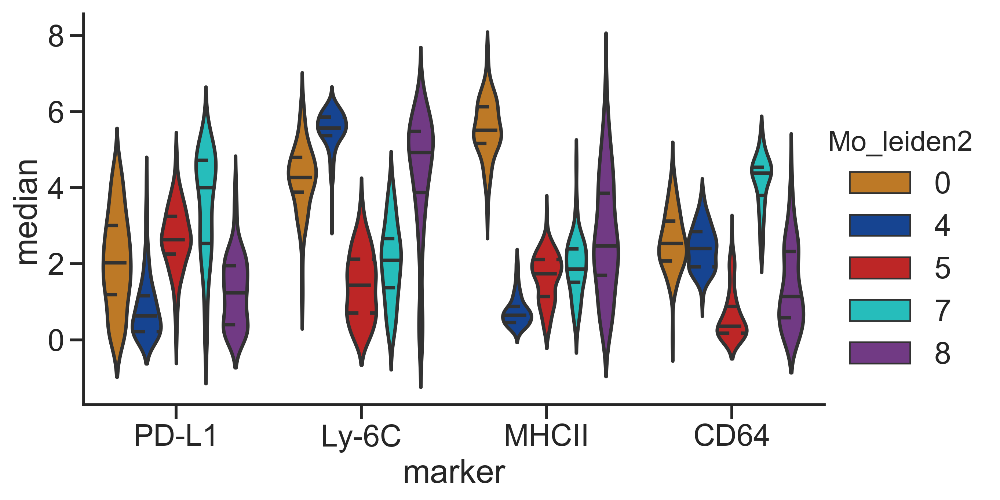

In [11]:
sns.set_style("ticks")
sns.catplot(x = 'marker', y = 'median', kind = 'violin',inner = 'quart',
            hue = 'Mo_leiden2', palette = Mo_leiden2_dict, order = ['PD-L1', 'Ly-6C','MHCII', 'CD64'],
            scale='count', ci = 68, data = median_df[median_df['marker'].isin(['PD-L1', 'Ly-6C','MHCII', 'CD64']) & median_df['Mo_leiden2'].isin(['0', '4','5', '7', '8'])],
            legend_out = True, aspect = 1.6, height = 5)

In [12]:
from scipy.stats import ttest_ind
t_test_data = pd.DataFrame(columns =['cluster1', 'cluster2', 'marker','t-stat', 'p-value', 'Stat diff'])
leiden_combos = [('0', '4'), ('0', '5'), ('0', '7'), ('0', '8'), ('4', '5'), ('4', '7'), ('4', '8'), ('5', '7'), ('5', '8'), ('7', '8')]
for leiden_comb in leiden_combos:
    for marker in ['PD-L1', 'Ly-6C','MHCII', 'CD64']:
    
            marker_leiden1 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[0])]
            marker_leiden2 = median_df[(median_df['marker']== marker) & 
                                    (median_df['Mo_leiden2']== leiden_comb[1])]

            t_stat, p = ttest_ind(marker_leiden1['median'], marker_leiden2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'cluster1': [leiden_comb[0]],
                                          'cluster2': [leiden_comb[1]],
                                          'marker': [marker], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_data = t_test_data.append(data_df)

In [13]:
t_test_data

,cluster1,cluster2,marker,t-stat,p-value,Stat diff
0,0,4,PD-L1,8.797054,3.520558e-16,yes
0,0,4,Ly-6C,-13.090119,1.425131e-29,yes
0,0,4,MHCII,60.797365,7.092695e-143,yes
0,0,4,CD64,2.161952,3.166297e-02,yes
0,0,5,PD-L1,-4.448296,1.343290e-05,yes
0,0,5,Ly-6C,23.884598,1.882287e-64,yes
0,0,5,MHCII,42.873642,3.052953e-112,yes
0,0,5,CD64,21.246851,2.398973e-56,yes
0,0,7,PD-L1,-7.764782,4.763171e-13,yes
0,0,7,Ly-6C,15.803163,1.389232e-36,yes


# Figure 3E

In [139]:
mono_clean_df['Mo_leiden2'] = mono_clean_df['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [140]:
PB = mono_clean_df[mono_clean_df['compartment2'] == 'PB-EV']
EV = mono_clean_df[mono_clean_df['compartment2'] == 'PL-EV']
TIS =mono_clean_df[mono_clean_df['compartment2']=='PL-T']

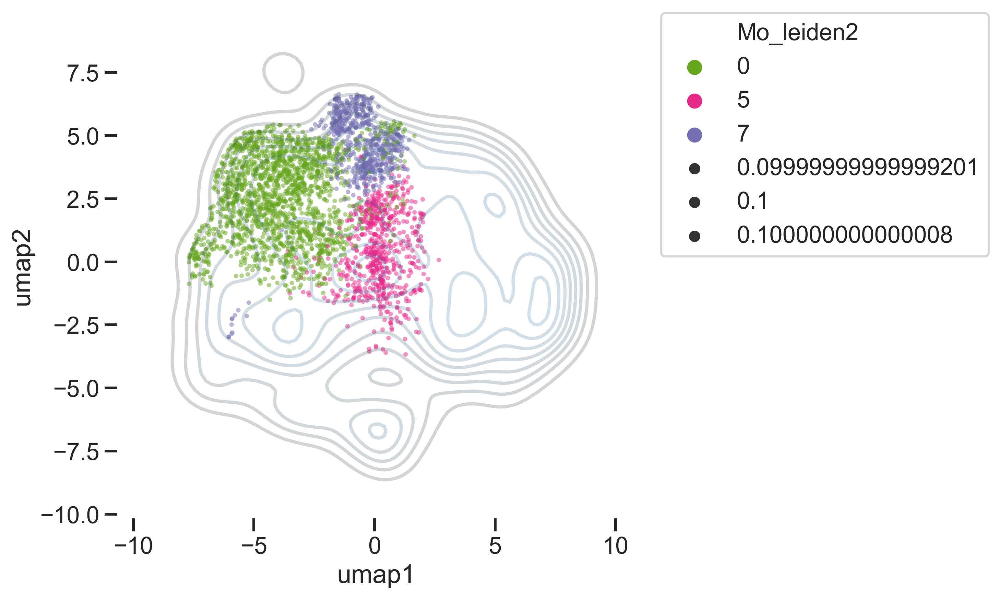

In [167]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS[TIS['Mo_leiden2'].isin(['0', '5', '7'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

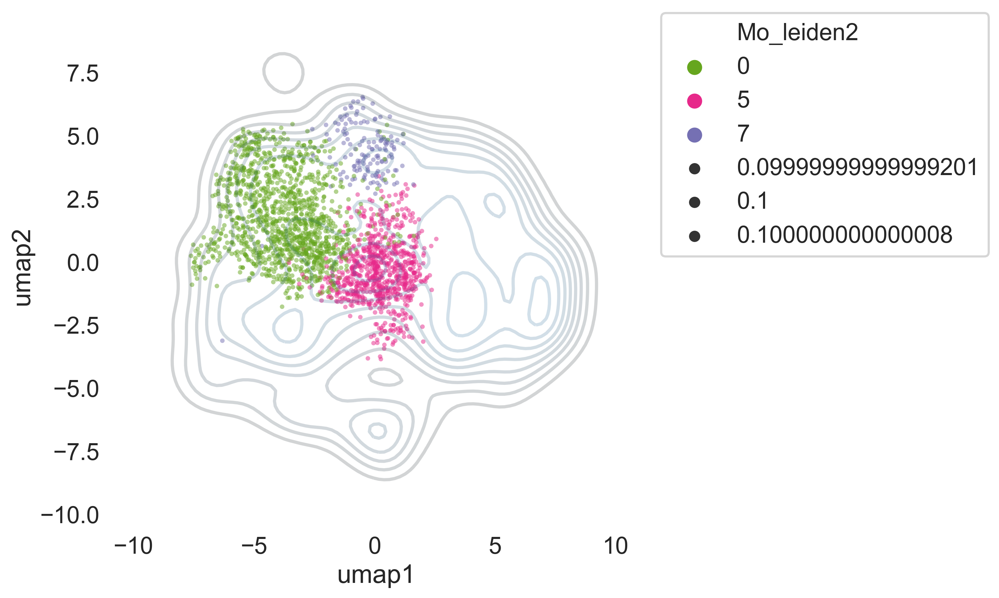

In [168]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV[EV['Mo_leiden2'].isin(['0', '5', '7'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

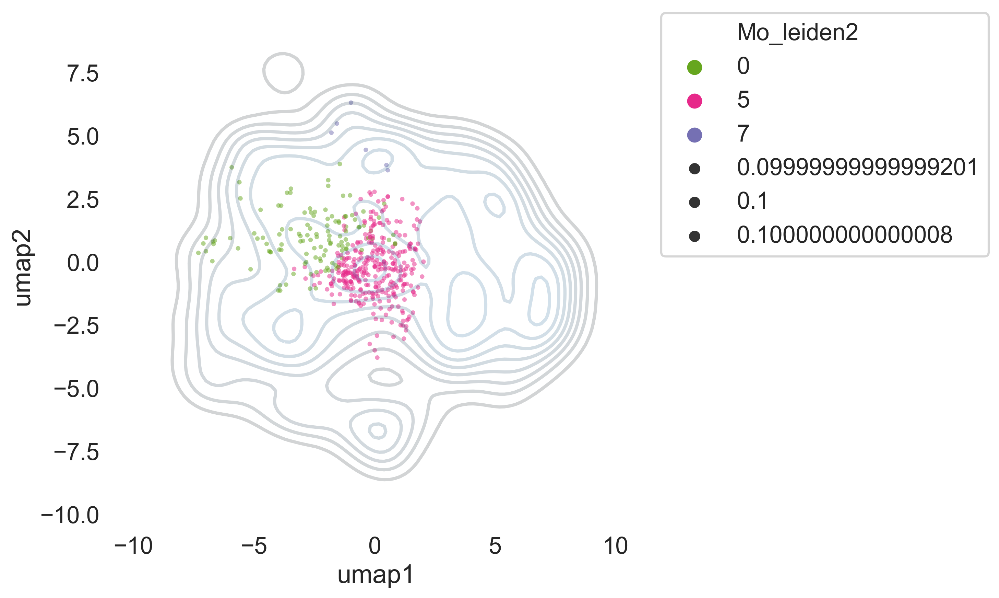

In [169]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB[PB['Mo_leiden2'].isin(['0', '5', '7'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Supp Figure 3E

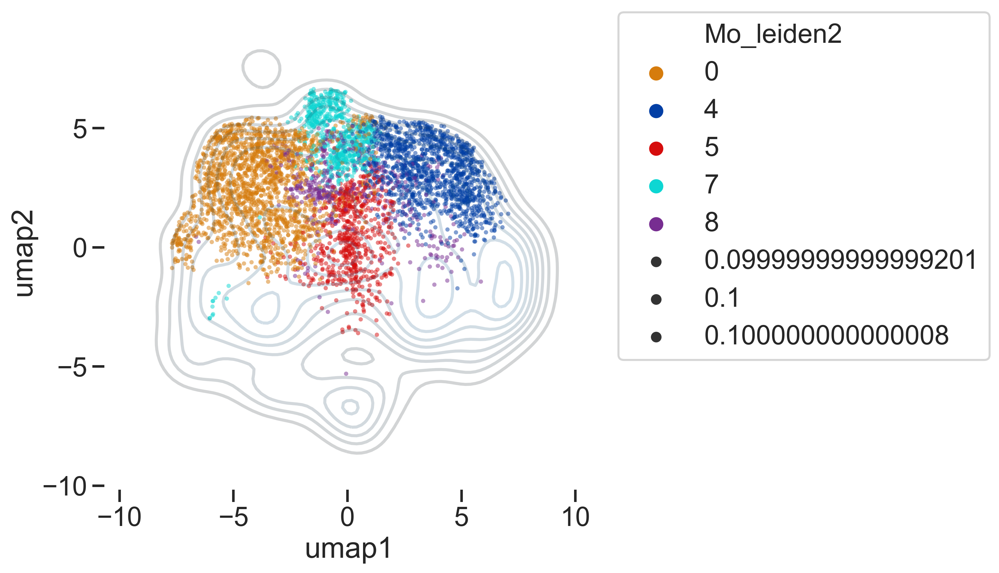

In [16]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = TIS[TIS['Mo_leiden2'].isin(['0','4' ,'5', '7', '8'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

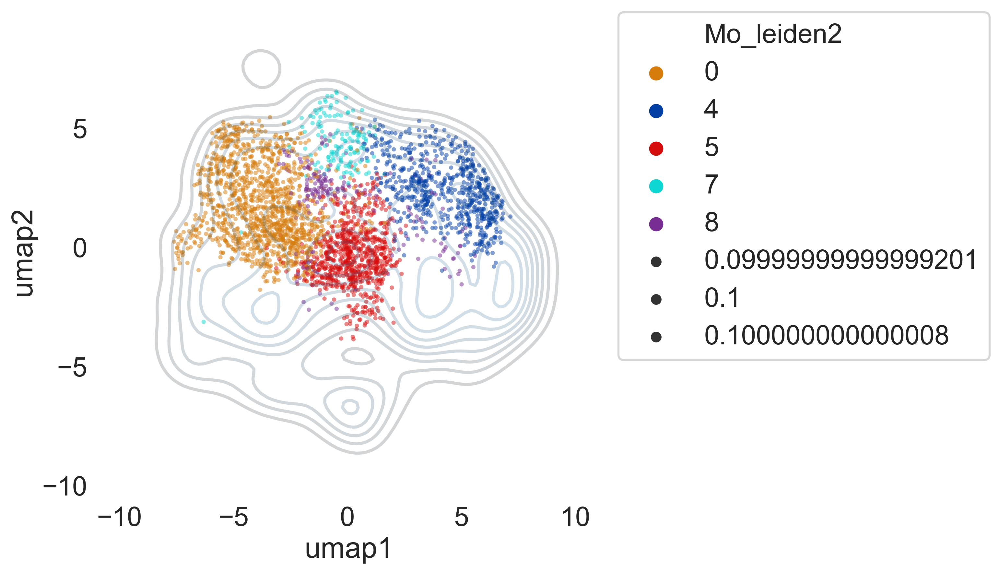

In [17]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = EV[EV['Mo_leiden2'].isin(['0','4' ,'5', '7', '8'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

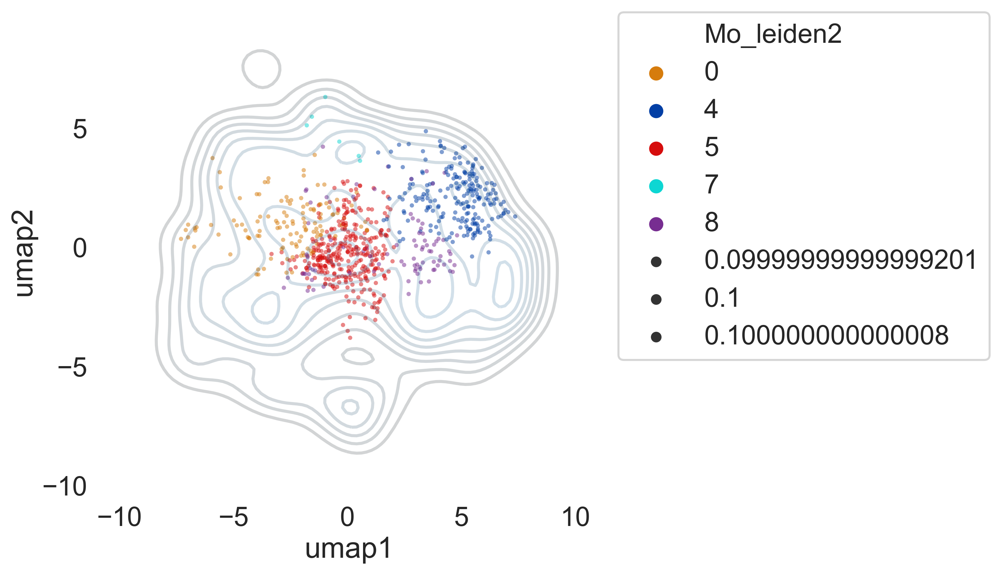

In [18]:
f, ax = plt.subplots(figsize=(6.5, 6.5))
sns.kdeplot(data = mono_clean_df['umap1'], data2= mono_clean_df['umap2'], shade = False, 
            shade_lowest=False, ax = ax, alpha = 0.2, cbar = False)
sns.scatterplot(data = PB[PB['Mo_leiden2'].isin(['0','4' ,'5', '7', '8'])], hue = 'Mo_leiden2', palette = Mo_leiden2_dict, x='umap1', y='umap2', marker='.', size = 0.1, linewidth = 0, alpha = 0.5, ax = ax)
sns.despine(f, left=True, bottom=True)
sns.set_style("whitegrid", {'axes.grid' : False})
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Figure 3F

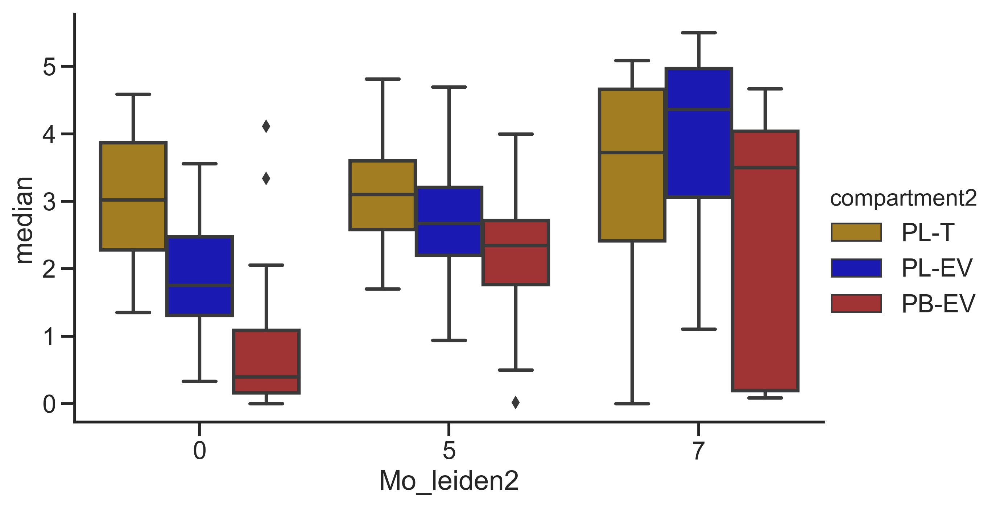

In [62]:
sns.set_style("ticks")
sns.catplot(x = 'Mo_leiden2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['PD-L1']) & median_df['Mo_leiden2'].isin(['0', '5', '7'])],
            legend_out = True, aspect = 1.6, height = 5)

In [ ]:
from scipy.stats import ttest_ind

In [83]:
median_df.head(5)

,marker,Mo_leiden2,compartment2,challenge,cage,id,day,median
0,CD45-retroorbital,0,PB-EV,sal,428,14,E12.5,4.603326
1,CD45-retroorbital,0,PB-EV,sal,429,16,E18.5,4.903420
2,CD45-retroorbital,0,PB-EV,sal,429,20,E18.5,4.715041
3,CD45-retroorbital,0,PB-EV,sal,439,6,E14.5,0.041249
4,CD45-retroorbital,0,PB-EV,sal,748,5,E12.5,1.707534


In [84]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']

In [85]:
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])

In [86]:
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]

In [87]:
for comb in combos:
    for cluster in ['0', '5','7']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [88]:
t_test_pdl1 

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-EV,PB-EV,0,4.891791,6.730013e-06,yes
0,PL-EV,PB-EV,5,2.474621,1.556671e-02,yes
0,PL-EV,PB-EV,7,2.317030,2.665784e-02,yes


# Supp Figure 3F

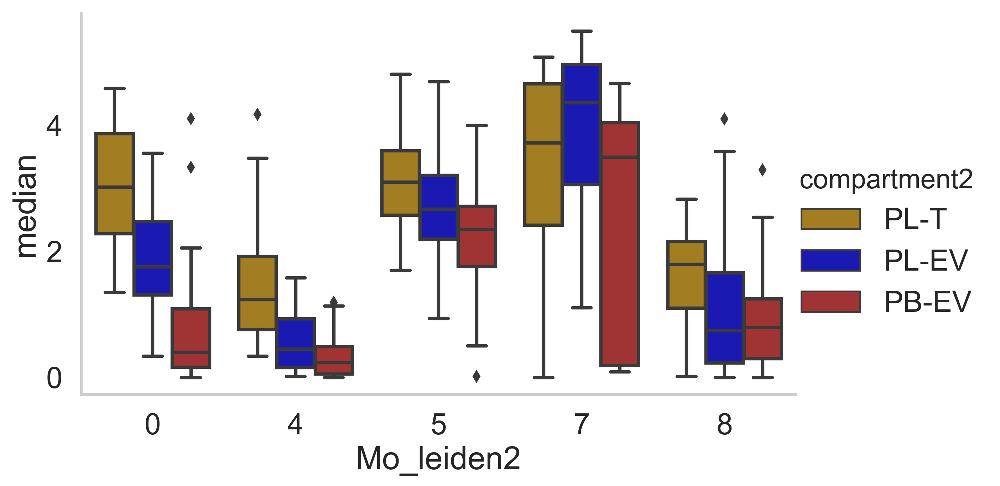

In [19]:
sns.catplot(x = 'Mo_leiden2', y = 'median', kind = 'box', hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
            hue = 'compartment2', palette = {'PB-EV':'firebrick', 'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod'},
            ci = 68, data = median_df[median_df['marker'].isin(['PD-L1']) & median_df['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])],
            legend_out = True, aspect = 1.6, height = 5)

In [20]:
pdl1_medians = median_df[median_df['marker'] == 'PD-L1']
t_test_pdl1 = pd.DataFrame(columns =['comp1', 'comp2', 'cluster','t-stat', 'p-value', 'Stat diff'])
combos = [('PL-T', 'PL-EV'), ('PL-T', 'PB-EV'),('PL-EV', 'PB-EV')]
for comb in combos:
    for cluster in ['0', '4', '5','7', '8']:
    
            comp1 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[0])]
            comp2 = pdl1_medians[(pdl1_medians['Mo_leiden2']== cluster) & 
                                    (pdl1_medians['compartment2']== comb[1])]

            t_stat, p = ttest_ind(comp1['median'], comp2['median'])
            alpha = 0.05
            if p > alpha:
                dist = 'no'
            else:
                dist = 'yes'
            data_df = pd.DataFrame(data ={'comp1': [comb[0]],
                                          'comp2': [comb[1]],
                                          'cluster': [cluster], 
                                          't-stat': [t_stat], 
                                          'p-value': [p], 
                                          'Stat diff':[ dist]})
            t_test_pdl1 = t_test_pdl1.append(data_df)

In [21]:
t_test_pdl1

,comp1,comp2,cluster,t-stat,p-value,Stat diff
0,PL-T,PL-EV,0,6.287519,1.483718e-08,yes
0,PL-T,PL-EV,4,5.717353,1.746087e-07,yes
0,PL-T,PL-EV,5,2.826176,5.947359e-03,yes
0,PL-T,PL-EV,7,-2.103178,3.885013e-02,yes
0,PL-T,PL-EV,8,2.153158,3.456505e-02,yes
0,PL-T,PB-EV,0,9.925185,4.052746e-15,yes
0,PL-T,PB-EV,4,6.906520,1.248876e-09,yes
0,PL-T,PB-EV,5,5.446111,5.512350e-07,yes
0,PL-T,PB-EV,7,1.266058,2.116026e-01,no
0,PL-T,PB-EV,8,3.024502,3.582091e-03,yes


# Figure 3G

In [93]:
clean_cell_counts.head()

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,14,6942_8_E10.5_sal_2hr_PB_EV,60,0.233333
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,16,6943_15_E10.5_sal_2hr_PB_EV,62,0.258065
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,11,6944_16_E10.5_sal_2hr_PB_EV,67,0.164179
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,1,6944_17_E10.5_sal_2hr_PB_EV,32,0.031250
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,4,9582_15_E10.5_sal_2hr_PB_EV,36,0.111111


In [94]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
full_counts_csv = '20200521_maternal500wo_outliers_counts_per_sample_meta_clust.csv'
full_counts_filepath = os.path.join(subsample_path, full_counts_csv)
full_cell_counts = pd.read_csv(full_counts_filepath)  

In [95]:
full_cell_counts.head()

,cell_type_v2,compartment,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,compartment2
0,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,194,6942_8_E10.5_sal_2hr_PB_EV,494,0.392713,PB-EV
1,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,251,6943_15_E10.5_sal_2hr_PB_EV,484,0.518595,PB-EV
2,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,142,6944_16_E10.5_sal_2hr_PB_EV,496,0.286290,PB-EV
3,B cells,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,242,6944_17_E10.5_sal_2hr_PB_EV,485,0.498969,PB-EV
4,B cells,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,135,9582_15_E10.5_sal_2hr_PB_EV,459,0.294118,PB-EV


In [96]:
samp_total_df = full_cell_counts.loc[:, ['sample', 'sample_total']]
samp_total_df.set_index('sample', inplace = True)
total_counts_dict = samp_total_df.to_dict()

In [97]:
cell_counts.loc[:,'full_sample_total'] = cell_counts.loc[:,'sample'].map(total_counts_dict['sample_total'])
cell_counts['frac_of_immune'] = cell_counts['counts']/cell_counts['full_sample_total']                                          
clean_counts_full = cell_counts[cell_counts['test_status'] == 'test']

In [98]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200928_maternalmo_nopdl1clust_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full.to_csv(counts_filepath, index = False)  

In [99]:
clean_counts_full.head(5)

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,14,6942_8_E10.5_sal_2hr_PB_EV,60,0.233333,494.0,0.028340
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,16,6943_15_E10.5_sal_2hr_PB_EV,62,0.258065,484.0,0.033058
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,11,6944_16_E10.5_sal_2hr_PB_EV,67,0.164179,496.0,0.022177
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,1,6944_17_E10.5_sal_2hr_PB_EV,32,0.031250,485.0,0.002062
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,4,9582_15_E10.5_sal_2hr_PB_EV,36,0.111111,459.0,0.008715


In [35]:
clean_counts_full['PDL1_status'] = np.where(clean_counts_full['Mo_leiden2'].isin(['0', '5', '7']), 'pos', 'neg')
PDL1_counts_df = clean_counts_full.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()
clean_counts_full.loc[:,'pdl1_counts'] = clean_counts_full.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_counts_full[clean_counts_full['Mo_leiden2'].isin(['0', '5', '7'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_counts_full['pdl1_counts'] 
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
pdl1_clustcounts_csv = '20200928_maternalmo_pdl1_clust_counts_per_sample.csv'
pdl1_clustcounts_filepath = os.path.join(subsample_path, pdl1_clustcounts_csv)
pdl1_clust.to_csv(pdl1_clustcounts_filepath, index = False)  

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [73]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
pdl1_clustcounts_csv = '20200928_maternalmo_pdl1_clust_counts_per_sample.csv'
pdl1_clustcounts_filepath = os.path.join(subsample_path, pdl1_clustcounts_csv)
full_counts = pd.read_csv(pdl1_clustcounts_filepath)  

In [74]:
pdl1_clust = full_counts[~(full_counts['timePI'] == '24hr')]

In [75]:
pdl1_clust['Mo_leiden2']= pdl1_clust['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [76]:
pdl1_clust.head()

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune,PDL1_status,pdl1_counts,frac_of_pdl1_pos
0,0,PB-EV,PB,EV,E10.5,sal,2hr,6942,8,test,14,6942_8_E10.5_sal_2hr_PB_EV,60,0.233333,494.0,0.028340,pos,22.0,0.636364
1,0,PB-EV,PB,EV,E10.5,sal,2hr,6943,15,test,16,6943_15_E10.5_sal_2hr_PB_EV,62,0.258065,484.0,0.033058,pos,25.0,0.640000
2,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,16,test,11,6944_16_E10.5_sal_2hr_PB_EV,67,0.164179,496.0,0.022177,pos,24.0,0.458333
3,0,PB-EV,PB,EV,E10.5,sal,2hr,6944,17,test,1,6944_17_E10.5_sal_2hr_PB_EV,32,0.031250,485.0,0.002062,pos,5.0,0.200000
4,0,PB-EV,PB,EV,E10.5,sal,2hr,9582,15,test,4,9582_15_E10.5_sal_2hr_PB_EV,36,0.111111,459.0,0.008715,pos,13.0,0.307692


In [77]:
int_days = ['E10.5', 'E14.5', 'E18.5']

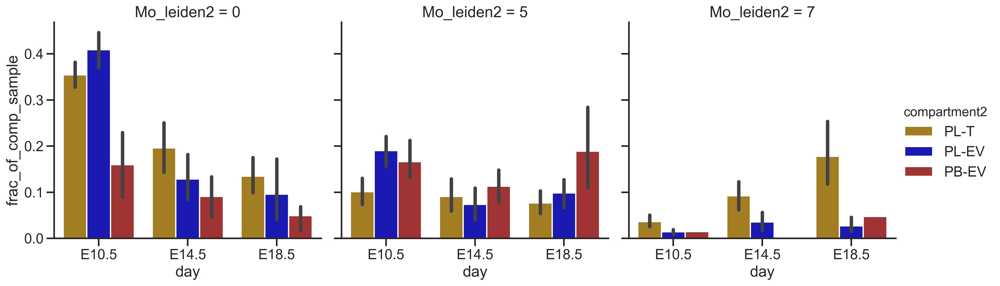

In [78]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

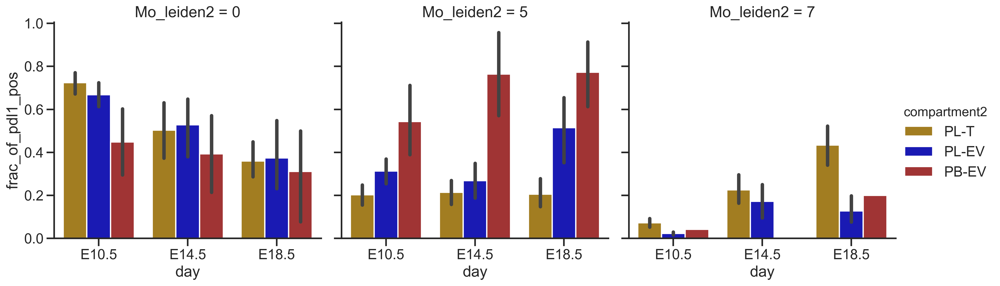

In [79]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_pdl1_pos',
                col='Mo_leiden2', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [80]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '5','7']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [81]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,2.425484,0.029397,yes,PL-T,PL-EV,E10.5,1.367552,0.201400,no
0,0,PL-T,E14.5,E18.5,1.680089,0.112356,no,PL-T,PL-EV,E14.5,-0.249149,0.806067,no
0,0,PL-T,E18.5,E10.5,-6.271649,0.000041,yes,PL-T,PL-EV,E18.5,-0.143266,0.888122,no
0,0,PL-EV,E10.5,E14.5,1.480339,0.160933,no,PL-EV,PB-EV,E10.5,2.559459,0.030714,yes
0,0,PL-EV,E14.5,E18.5,1.374566,0.188213,no,PL-EV,PB-EV,E14.5,0.957117,0.359071,no
0,0,PL-EV,E18.5,E10.5,-2.726116,0.018398,yes,PL-EV,PB-EV,E18.5,0.375300,0.716129,no
0,0,PB-EV,E10.5,E14.5,0.400098,0.702940,no,PB-EV,PL-T,E10.5,-3.240483,0.010151,yes
0,0,PB-EV,E14.5,E18.5,0.504778,0.640255,no,PB-EV,PL-T,E14.5,-0.812112,0.433951,no
0,0,PB-EV,E18.5,E10.5,-0.926762,0.389807,no,PB-EV,PL-T,E18.5,-0.467435,0.651299,no
0,5,PL-T,E10.5,E14.5,-0.239380,0.814544,no,PL-T,PL-EV,E10.5,-2.581458,0.027348,yes


In [82]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
pdl1_cluststats_csv = '20200928_maternalmo_pdl1_clust_counts_stats.csv'
pdl1_cluststats_filepath = os.path.join(subsample_path, pdl1_cluststats_csv) 
t_test_pdl1_frac.to_csv(pdl1_cluststats_filepath, index = False)

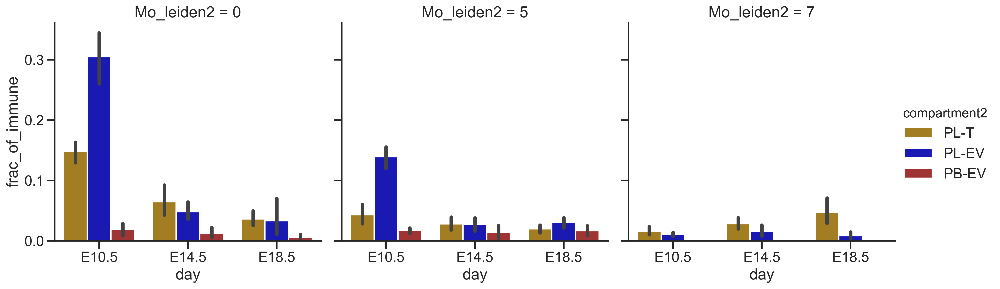

In [83]:
sns.set_style("ticks")
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [84]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '5','7']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [85]:
day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E10.5')]

In [86]:
pdl1_clust[(pdl1_clust['Mo_leiden2']== '0') & 
                                        (pdl1_clust['compartment2']== 'PL-T')&
                                        (pdl1_clust['day']== 'E14.5')]

,Mo_leiden2,compartment2,organ,location,day,challenge,timePI,cage,id,test_status,counts,sample,sample_total,frac_of_comp_sample,full_sample_total,frac_of_immune,PDL1_status,pdl1_counts,frac_of_pdl1_pos
114,0,PL-T,PL_F,T,E14.5,sal,2hr,1136,1,test,23,1136_1_E14.5_sal_2hr_PL_F_T,125,0.184000,321.0,0.071651,pos,31.0,0.741935
115,0,PL-T,PL_F,T,E14.5,sal,2hr,8240,11,test,21,8240_11_E14.5_sal_2hr_PL_F_T,133,0.157895,354.0,0.059322,pos,30.0,0.700000
116,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,6,9581_10_E14.5_sal_2hr_PL_F_T,50,0.120000,177.0,0.033898,pos,18.0,0.333333
117,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,10,test,2,9581_10_E14.5_sal_2hr_PL_F_T,50,0.040000,177.0,0.011299,pos,18.0,0.111111
118,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,8,test,7,9581_8_E14.5_sal_2hr_PL_F_T,29,0.241379,132.0,0.053030,pos,17.0,0.411765
119,0,PL-T,PL_F,T,E14.5,sal,2hr,9581,9,test,33,9581_9_E14.5_sal_2hr_PL_F_T,96,0.343750,209.0,0.157895,pos,51.0,0.647059
154,0,PL-T,PL_M,T,E14.5,sal,2hr,8240,11,test,32,8240_11_E14.5_sal_2hr_PL_M_T,103,0.310680,311.0,0.102894,pos,49.0,0.653061
155,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,10,test,8,9581_10_E14.5_sal_2hr_PL_M_T,45,0.177778,174.0,0.045977,pos,19.0,0.421053
156,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,8,test,14,9581_8_E14.5_sal_2hr_PL_M_T,54,0.259259,198.0,0.070707,pos,20.0,0.700000
157,0,PL-T,PL_M,T,E14.5,sal,2hr,9581,9,test,7,9581_9_E14.5_sal_2hr_PL_M_T,56,0.125000,163.0,0.042945,pos,22.0,0.318182


In [87]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.542092,4.605979e-04,yes,PL-T,PL-EV,E10.5,1.367552,0.201400,no
0,0,PL-T,E14.5,E18.5,1.830721,8.583120e-02,no,PL-T,PL-EV,E14.5,-0.249149,0.806067,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,-0.143266,0.888122,no
0,0,PL-EV,E10.5,E14.5,12.368634,6.336892e-09,yes,PL-EV,PB-EV,E10.5,2.559459,0.030714,yes
0,0,PL-EV,E14.5,E18.5,0.821600,4.233788e-01,no,PL-EV,PB-EV,E14.5,0.957117,0.359071,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.375300,0.716129,no
0,0,PB-EV,E10.5,E14.5,0.774439,4.680808e-01,no,PB-EV,PL-T,E10.5,-3.240483,0.010151,yes
0,0,PB-EV,E14.5,E18.5,1.195603,2.978840e-01,no,PB-EV,PL-T,E14.5,-0.812112,0.433951,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-0.467435,0.651299,no
0,5,PL-T,E10.5,E14.5,1.516010,1.534499e-01,no,PL-T,PL-EV,E10.5,-2.581458,0.027348,yes


In [88]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
immune_cluststats_csv = '20200929_maternalmo_pdl1_ouof_immune_counts_stats.csv'
immune_cluststats_filepath = os.path.join(subsample_path, immune_cluststats_csv) 
t_test_immune_frac.to_csv(immune_cluststats_filepath, index = False)

# Supp Figure 3G

In [23]:
subsample_path = '/Users/bendalllab/Desktop/Maternal_cells/500_sub'
counts_csv = '20200928_maternalmo_nopdl1clust_cell_type_counts_per_sample.csv'
counts_filepath = os.path.join(subsample_path, counts_csv)
clean_counts_full= pd.read_csv(counts_filepath)

In [56]:
clean_counts_full['PDL1_status'] = np.where(clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8']), 'pos', 'neg')
PDL1_counts_df = clean_counts_full.groupby(['PDL1_status', 'sample']).sum()
pdl1_dict = PDL1_counts_df.loc['pos', 'counts'].to_dict()
clean_counts_full.loc[:,'pdl1_counts'] = clean_counts_full.loc[:,'sample'].map(pdl1_dict)
pdl1_clust = clean_counts_full[clean_counts_full['Mo_leiden2'].isin(['0', '4', '5', '7', '8'])]
pdl1_clust['frac_of_pdl1_pos'] = pdl1_clust['counts']/clean_counts_full['pdl1_counts'] 

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  


In [59]:
pdl1_clust['Mo_leiden2']= pdl1_clust['Mo_leiden2'].astype('str')

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [28]:
int_days = ['E10.5', 'E14.5', 'E18.5']

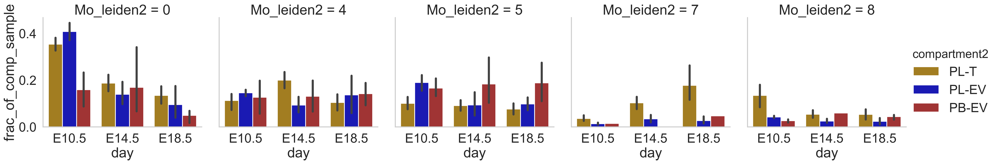

In [29]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_comp_sample',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

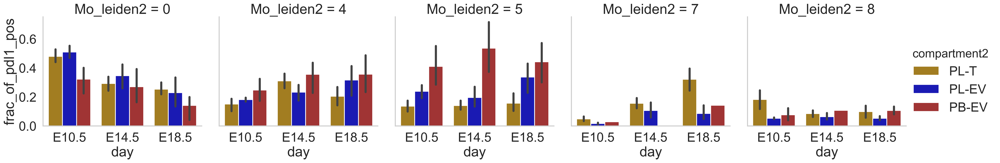

In [30]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_pdl1_pos',
                col='Mo_leiden2', data=  pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [60]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_pdl1_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4','5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_pdl1_pos'], day2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_pdl1_frac = t_test_pdl1_frac.append(data_df)

In [61]:
t_test_pdl1_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,4.103838,0.000507,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,0.969763,0.342253,no,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-6.510501,0.000029,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,2.467790,0.026112,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,1.621616,0.123284,no,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-4.106602,0.001455,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,0.603996,0.562578,no,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,1.338437,0.229239,no,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-2.236397,0.066677,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,-3.477520,0.002376,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no


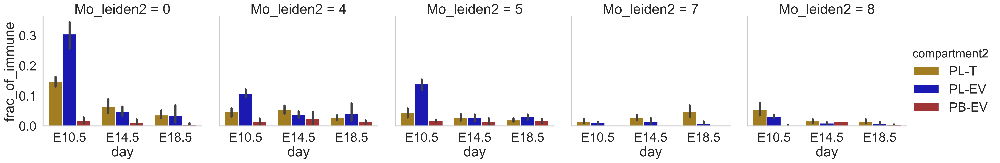

In [34]:
sns.set_context('talk', font_scale= 1.5)
g = sns.catplot(x='day', y='frac_of_immune',
                col='Mo_leiden2', data= pdl1_clust[pdl1_clust['day'].isin(int_days)], 
                kind='bar', hue = 'compartment2',hue_order = ['PL-T', 'PL-EV', 'PB-EV'],
                palette= {'PL-EV': 'mediumblue', 'PL-T': 'darkgoldenrod', 'PB-EV':'firebrick',}, sharey = True,
                height=5, aspect=1)

In [62]:
days = [('E10.5', 'E14.5'), ('E14.5', 'E18.5'), ('E18.5', 'E10.5')]
combos = [('PL-T', 'PL-EV'), ('PL-EV', 'PB-EV'), ('PB-EV', 'PL-T')]
t_test_immune_frac = pd.DataFrame(columns =['cluster', 'comp_only','day1', 'day2', 't-stat_day', 'p-value_day', 'Stat diff day', 'comp1', 'comp2', 'day_only', 't-stat_comp', 'p-value_comp', 'Stat diff comp'])

for cluster in ['0', '4', '5','7', '8']:   
    for comb in combos:
        for day in days: 
                day1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                day2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[1])]

                t_stat_day, p_day = ttest_ind(day1['frac_of_immune'], day2['frac_of_immune'])
                alpha = 0.05
                if p_day > alpha:
                    dist_day = 'no'
                else:
                    dist_day = 'yes'

                comp_1 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[0])&
                                        (pdl1_clust['day']== day[0])]
                comp_2 = pdl1_clust[(pdl1_clust['Mo_leiden2']== cluster) & 
                                        (pdl1_clust['compartment2']== comb[1])&
                                        (pdl1_clust['day']== day[0])]

                t_stat_comp, p_comp = ttest_ind(comp_1['frac_of_pdl1_pos'], comp_2['frac_of_pdl1_pos'])
                alpha = 0.05
                if p_comp > alpha:
                    dist_comp = 'no'
                else:
                    dist_comp = 'yes'


                data_df = pd.DataFrame(data ={'cluster': [cluster],
                                              'comp_only': [comb[0]],
                                              'day1':[day[0]],
                                              'day2':[day[1]],
                                              't-stat_day': [t_stat_day], 
                                              'p-value_day': [p_day], 
                                              'Stat diff day':[ dist_day],
                                              'comp1': [comb[0]],
                                              'comp2': [comb[1]],
                                              'day_only':[day[0]],
                                              't-stat_comp': [t_stat_comp], 
                                              'p-value_comp': [p_comp], 
                                              'Stat diff comp':[ dist_comp]})
                t_test_immune_frac = t_test_immune_frac.append(data_df)

In [63]:
t_test_immune_frac

,cluster,comp_only,day1,day2,t-stat_day,p-value_day,Stat diff day,comp1,comp2,day_only,t-stat_comp,p-value_comp,Stat diff comp
0,0,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-0.875358,0.401915,no
0,0,PL-T,E14.5,E18.5,NaN,NaN,yes,PL-T,PL-EV,E14.5,-1.113328,0.275755,no
0,0,PL-T,E18.5,E10.5,-10.016608,3.517673e-07,yes,PL-T,PL-EV,E18.5,0.395305,0.698576,no
0,0,PL-EV,E10.5,E14.5,NaN,NaN,yes,PL-EV,PB-EV,E10.5,3.392448,0.007968,yes
0,0,PL-EV,E14.5,E18.5,NaN,NaN,yes,PL-EV,PB-EV,E14.5,0.926070,0.370099,no
0,0,PL-EV,E18.5,E10.5,-9.345872,7.401038e-07,yes,PL-EV,PB-EV,E18.5,0.891265,0.395989,no
0,0,PB-EV,E10.5,E14.5,NaN,NaN,yes,PB-EV,PL-T,E10.5,-2.803567,0.020592,yes
0,0,PB-EV,E14.5,E18.5,NaN,NaN,yes,PB-EV,PL-T,E14.5,-0.378149,0.709304,no
0,0,PB-EV,E18.5,E10.5,-1.668952,1.461684e-01,no,PB-EV,PL-T,E18.5,-2.312069,0.046080,yes
0,4,PL-T,E10.5,E14.5,NaN,NaN,yes,PL-T,PL-EV,E10.5,-1.193982,0.260039,no
